<a href="https://colab.research.google.com/github/mavenzozio/projects/blob/master/Deep_Learning_with_Cats_%26_Dogs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Cats VS Dogs 

Nous allons entrainer un CNN simple qui va reconnaitre des chiens et des chats dans un dataset ! 

In [0]:
!pip install tensorflow-gpu==2.0.0beta1

In [31]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

tf.__version__


'2.0.0-beta1'

* Nous allons utiliser un dataset exrcice proposé par Keras.


In [3]:
tf.keras.utils.get_file(fname = 'catsanddogs.zip', origin='https://storage.googleapis.com/mledu-datasets/cats_and_dogs_filtered.zip', extract = True)

68608000/68606236 [==============================] - 1s 0us/step


'/root/.keras/datasets/catsanddogs.zip'

* Nous utilisons la librairie [pathlib](https://docs.python.org/3/library/pathlib.html) pour gérer les chemins d'accès 

In [0]:
from pathlib import Path

In [0]:
path = Path('/root/.keras/datasets')

In [7]:
list(path.glob('*')) 
# Permet de regarder le contenu du fichier destination et retrouver ce qui a été dé-zippé

[PosixPath('/root/.keras/datasets/cats_and_dogs_filtered'),
 PosixPath('/root/.keras/datasets/catsanddogs.zip')]

In [11]:
print(list((path/'cats_and_dogs_filtered').glob('*')))
print("")

print(list((path/'cats_and_dogs_filtered/train').glob('*')))

print("")
print(list((path/'cats_and_dogs_filtered/validation').glob('*')))

[PosixPath('/root/.keras/datasets/cats_and_dogs_filtered/vectorize.py'), PosixPath('/root/.keras/datasets/cats_and_dogs_filtered/validation'), PosixPath('/root/.keras/datasets/cats_and_dogs_filtered/train')]

[PosixPath('/root/.keras/datasets/cats_and_dogs_filtered/train/dogs'), PosixPath('/root/.keras/datasets/cats_and_dogs_filtered/train/cats')]

[PosixPath('/root/.keras/datasets/cats_and_dogs_filtered/validation/dogs'), PosixPath('/root/.keras/datasets/cats_and_dogs_filtered/validation/cats')]


* Le dossier est déjà divisé en dataset d'entrainement et de validation, les images sont rangées dans des dossiers donnant leur label. 
* On stocke les liens vers les images et le label correspondant dans un dataset :
  * Chat = 1
  * Chien = 0  

In [0]:
pcats = Path('/root/.keras/datasets/cats_and_dogs_filtered/train/cats')
df_cats = pd.DataFrame(list(pcats.glob('*')))
df_cats.columns = ['image_link']
df_cats['cat'] = 1

In [0]:
pdogs = Path('/root/.keras/datasets/cats_and_dogs_filtered/train/dogs')
df_dogs = pd.DataFrame(list(pdogs.glob('*')))
df_dogs.columns = ['image_link']
df_dogs['cat'] = 0

In [82]:
df = df_cats.append(df_dogs, ignore_index=True)
df.sample(10)

,image_link,cat
277,/root/.keras/datasets/cats_and_dogs_filtered/t...,1
1229,/root/.keras/datasets/cats_and_dogs_filtered/t...,0
818,/root/.keras/datasets/cats_and_dogs_filtered/t...,1
1886,/root/.keras/datasets/cats_and_dogs_filtered/t...,0
1700,/root/.keras/datasets/cats_and_dogs_filtered/t...,0
1147,/root/.keras/datasets/cats_and_dogs_filtered/t...,0
931,/root/.keras/datasets/cats_and_dogs_filtered/t...,1
1571,/root/.keras/datasets/cats_and_dogs_filtered/t...,0
1175,/root/.keras/datasets/cats_and_dogs_filtered/t...,0
556,/root/.keras/datasets/cats_and_dogs_filtered/t...,1


* Pour pouvoir lire les fichiers d'images avec Tensorflow, nous avons besoin de convertir chacun des chemins en _string_ et non _posixpath_. Nous allons utiliser une list comprehension pour pouvoir stockez dans une liste et transformer chacun des chemins bytes

In [28]:
img_pth = df['image_link']
img_pth

0       /root/.keras/datasets/cats_and_dogs_filtered/t...
1       /root/.keras/datasets/cats_and_dogs_filtered/t...
2       /root/.keras/datasets/cats_and_dogs_filtered/t...
3       /root/.keras/datasets/cats_and_dogs_filtered/t...
4       /root/.keras/datasets/cats_and_dogs_filtered/t...
                              ...                        
1995    /root/.keras/datasets/cats_and_dogs_filtered/t...
1996    /root/.keras/datasets/cats_and_dogs_filtered/t...
1997    /root/.keras/datasets/cats_and_dogs_filtered/t...
1998    /root/.keras/datasets/cats_and_dogs_filtered/t...
1999    /root/.keras/datasets/cats_and_dogs_filtered/t...
Name: image_link, Length: 2000, dtype: object

In [0]:
img_links = [x.as_uri() for x in img_pth]
img_links

* Nous allons manipuler toutes ces image dans un Tenseur

In [0]:
tf_train_set = tf.data.Dataset.from_tensor_slices(img_links)

* Passons au preprocessing des images et à de la Data Augmentation. Créez une fonction *load_and_preprocess_images* qui prendra un argument _img_ qui sera un chemin vers une image. A l'intérieur de la fonction, _img_ va passer par le preprocessing suivant : 
  * [tf.io.read_file ](https://www.tensorflow.org/api_docs/python/tf/io/read_file)--> Converti le chemin bytes
  * [tf.image.decode_jpeg](https://www.tensorflow.org/api_docs/python/tf/io/decode_jpeg) ---> Converti les bytes en tenseurs 
  * [tf.image.resize](https://www.tensorflow.org/api_docs/python/tf/image/resize_images) ---> Ajuste la taille de toutes les images. On mettra du (192, 192)
  * [tf.image.random_flip_left_right ](https://www.tensorflow.org/api_docs/python/tf/image/random_flip_left_right)---> Applique un effet mirroir sur les images 
  * [tf.image.random_contrast](https://www.tensorflow.org/api_docs/python/tf/image/random_contrast) ---> Applique des effets de contraste aux images 
  * Enfin divisez votre _img_ par 255

In [0]:
def load_and_preprocess_images(img):
  img = tf.io.read_file(img)
  img = tf.image.decode_jpeg(img)
  img = tf.image.resize(img, size=[192,192])
  #img = tf.image.random_flip_left_right(img)
  #img = tf.image.random_contrast(img, lower = 0, upper = 1)
  return img/255


* En utilisant la méthode[ `.map`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#map), appliquez votre fonction *load_and_preprocess_images* sur tout votre dataset

In [0]:
 tf_train_set = tf_train_set.map(load_and_preprocess_images)

In [0]:
plt.imshow(tAnimals)

* Tentons de voir un exemple de notre dataset pour être sur que tout se soit bien passé. En utilisant, [`tf.take()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#take), créez une boucle pour voir une image sous  forme de tenseur. 

tf.Tensor(
[[[0.94824344 0.952165   0.8305964 ]
  [0.96284723 0.9667688  0.8452002 ]
  [0.9588848  0.9588848  0.84908086]
  ...
  [0.06282672 0.06674828 0.04321887]
  [0.09538271 0.09930428 0.07577487]
  [0.11186682 0.11578839 0.09225898]]

 [[0.9429949  0.94691646 0.8214263 ]
  [0.9522078  0.9561294  0.8322323 ]
  [0.9529412  0.9529412  0.84313726]
  ...
  [0.06838548 0.07230705 0.04877764]
  [0.09760647 0.10152803 0.07799862]
  [0.10345171 0.10737329 0.08384387]]

 [[0.9465482  0.9504698  0.8249796 ]
  [0.94669116 0.9506127  0.8267157 ]
  [0.95440644 0.958328   0.8367594 ]
  ...
  [0.07450981 0.07843138 0.05490196]
  [0.09963555 0.10355712 0.08002771]
  [0.1014716  0.10539316 0.08186375]]

 ...

 [[0.7624795  0.79385203 0.6095383 ]
  [0.76963145 0.801004   0.6166902 ]
  [0.7696228  0.7970738  0.6245248 ]
  ...
  [0.77939683 0.6539066  0.3676321 ]
  [0.7783842  0.652894   0.36661953]
  [0.7717728  0.6462826  0.3600081 ]]

 [[0.7708946  0.80226713 0.6179534 ]
  [0.77548826 0.8068608  0

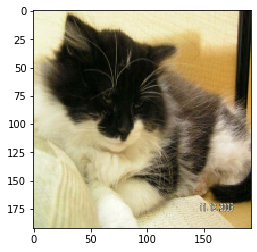

In [56]:
# Affichons un tenseur image et une image pour vérifier l'intégrité des données
for example_tensor in tf_train_set.take(1):
  print(example_tensor)
  plt.imshow(example_tensor)

* Nous allons maintenant nous occuper d'associer un label à chaque tenseur. Nous allons récupéré la liste de label créee dans le premier dataframe

In [83]:
tf_labels = tf.data.Dataset.from_tensor_slices(df['cat'])
for example in tf_labels.take(5):
  print(example)

tf.Tensor(1, shape=(), dtype=int32)
tf.Tensor(1, shape=(), dtype=int32)
tf.Tensor(1, shape=(), dtype=int32)
tf.Tensor(1, shape=(), dtype=int32)
tf.Tensor(1, shape=(), dtype=int32)


* Nous avons plus qu'à fusionner les deux `tf.data.Dataset` contenant les images et les labels pour avoir un dataset complet. 

In [88]:
full_ds = tf.data.Dataset.zip((tf_train_set, tf_labels))

for example in full_ds.take(1):
  print(example)

(<tf.Tensor: id=4114, shape=(192, 192, 3), dtype=float32, numpy=
array([[[0.94824344, 0.952165  , 0.8305964 ],
        [0.96284723, 0.9667688 , 0.8452002 ],
        [0.9588848 , 0.9588848 , 0.84908086],
        ...,
        [0.06282672, 0.06674828, 0.04321887],
        [0.09538271, 0.09930428, 0.07577487],
        [0.11186682, 0.11578839, 0.09225898]],

       [[0.9429949 , 0.94691646, 0.8214263 ],
        [0.9522078 , 0.9561294 , 0.8322323 ],
        [0.9529412 , 0.9529412 , 0.84313726],
        ...,
        [0.06838548, 0.07230705, 0.04877764],
        [0.09760647, 0.10152803, 0.07799862],
        [0.10345171, 0.10737329, 0.08384387]],

       [[0.9465482 , 0.9504698 , 0.8249796 ],
        [0.94669116, 0.9506127 , 0.8267157 ],
        [0.95440644, 0.958328  , 0.8367594 ],
        ...,
        [0.07450981, 0.07843138, 0.05490196],
        [0.09963555, 0.10355712, 0.08002771],
        [0.1014716 , 0.10539316, 0.08186375]],

       ...,

       [[0.7624795 , 0.79385203, 0.6095383 ],
   

* Maintenant, nous avons besoin de mélanger notre dataset et de créer des batch d'images. Le modèle sera entrainé batch par batch pour diminuer le temps de traitement


In [0]:
full_ds = full_ds.shuffle(2000).batch(16)
# full_ds est un objet spécial qui contient tous nos batchs de 16 tenseurs mélangés

In [91]:
full_ds

<BatchDataset shapes: ((None, 192, 192, None), (None,)), types: (tf.float32, tf.int32)>

* Regardons quelques images. Nous allons afficher la 1ere image de 10 batch 

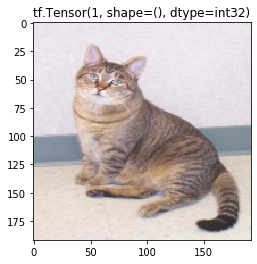

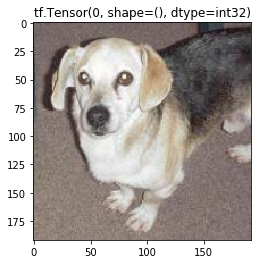

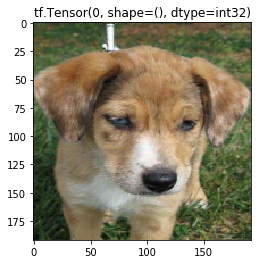

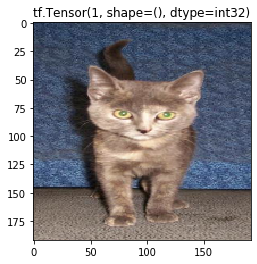

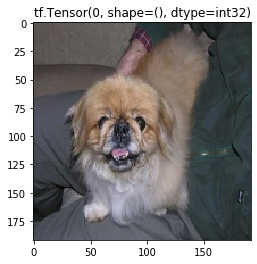

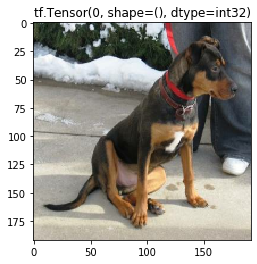

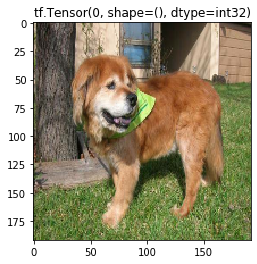

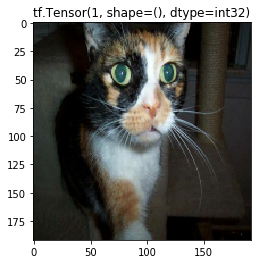

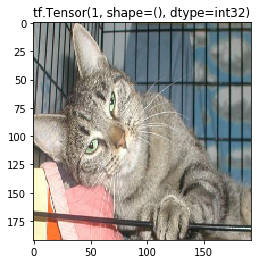

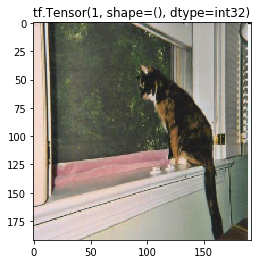

In [92]:
for example_x, example_y in full_ds.take(10):
  plt.figure()
  plt.title(example_y[0])
  plt.imshow(example_x[0].numpy())
  
plt.show() 

* Passons maintenant à la création d'un modèle ! Nous allons construire un réseau de neurone convolutif.
  * En utilisant [`tf.keras.Sequential`](https://www.tensorflow.org/api_docs/python/tf/keras/Sequential) & [`tf.keras.layers`](https://www.tensorflow.org/api_docs/python/tf/keras/layers)
  
  * La structure sera suivante : 
    * Deux à trois couches Conv2D & MaxPool2D -- Pour extraire les feature importante des images
    * Une couche qui va applatir les tenseurs (tf.keras.layers.Flatten)
    * Deux à quatre couches Fully Connected (Denses) (`tf.keras.layers.Dense`) -- Pour reconnaitre les features
    * Ajoutez des couches de Dropout pour eviter de l'overfitting.
    * La dernière couche contient des fonctions d'activation `sigmoid` pour sortir une probabilité et déterminer la meilleure classification de l'image

In [76]:
model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(filters=32, kernel_size=3, padding="same", activation="relu", input_shape=[192, 192, 3]),
    tf.keras.layers.MaxPool2D(pool_size=2, strides=2, padding='valid'),

    tf.keras.layers.Conv2D(filters=32, kernel_size=3, padding="same", activation="relu"),
    tf.keras.layers.MaxPool2D(pool_size=2, strides=2, padding='valid'),

    tf.keras.layers.Conv2D(filters=64, kernel_size=3, padding="same", activation="relu"),
    tf.keras.layers.MaxPool2D(pool_size=2, strides=2, padding='valid'),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(units=64, activation='relu'),
    tf.keras.layers.Dropout(0.05),
    tf.keras.layers.Dense(units=32, activation ="relu"),
    tf.keras.layers.Dense(units=16, activation ="relu"),
    tf.keras.layers.Dense(units=1, activation='sigmoid')
])

print("Done.")

Done.


* Mettons en place un `learning_rate` schedule. Ceci va nous permettre de faire baisser le *learning_rate* à mesure que l'on entraine le modèle. 

In [77]:
initial_learning_rate = 0.0001

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=500,
    decay_rate=0.96,
    staircase=True)
print("Done.")

Done.


* On va maintenant instancier [ `model.compile`](https://www.tensorflow.org/api_docs/python/tf/keras/Model#compile)afin de donner à notre modèles les paramètres nécessaires pour démarrer l'entrainement.
  * La fonction de coût à minimiser (loss), ici : `binary crossentropy`
  * La méthode pour diminuer la fonction de coût, ici : optimizer Adam 
  * La metric donnant la performance du modèle , ici : `binary accuracy`

In [78]:
model.compile(optimizer = tf.keras.optimizers.Adam(lr_schedule),
              loss= tf.keras.losses.binary_crossentropy,
              metrics = [tf.keras.metrics.binary_accuracy])

print("Done.")

Done.


* Le modèle est prêt ! Les poids sont initialisés aléatoirement. Nous allons entrainez notre modèle sur 30 epochs (30 feedforward et backpropagation avec un update des poids à chaque cycle). 


In [93]:
model.fit(full_ds, epochs=30)

Epoch 1/30
125/125 [==============================] - 11s 88ms/step - loss: 0.6893 - binary_accuracy: 0.5370
Epoch 2/30
125/125 [==============================] - 6s 45ms/step - loss: 0.6707 - binary_accuracy: 0.5860
Epoch 3/30
125/125 [==============================] - 6s 44ms/step - loss: 0.6104 - binary_accuracy: 0.6725
Epoch 4/30
125/125 [==============================] - 5s 43ms/step - loss: 0.5600 - binary_accuracy: 0.7155
Epoch 5/30
125/125 [==============================] - 5s 44ms/step - loss: 0.5168 - binary_accuracy: 0.7550
Epoch 6/30
125/125 [==============================] - 5s 44ms/step - loss: 0.4821 - binary_accuracy: 0.7785
Epoch 7/30
125/125 [==============================] - 5s 42ms/step - loss: 0.4387 - binary_accuracy: 0.8065
Epoch 8/30
125/125 [==============================] - 5s 43ms/step - loss: 0.3946 - binary_accuracy: 0.8265
Epoch 9/30
125/125 [==============================] - 5s 43ms/step - loss: 0.3518 - binary_accuracy: 0.8485
Epoch 10/30
125/125 [======

* Remarquons que la loss baisse à chaque cycle, pendant que notre performance augmente. Le modèle fonctionne bien.
* Les résultats sont satisfaisant ! Le modèle classe correctement 99,5% des images du train set.

Il faut maintenant le tester sur nos données de validation.
Les images du dossier validation doivent être traitées de la même manière que les données d'entrainement avant de les tester sur le modèle.

In [0]:
pcats = Path('/root/.keras/datasets/cats_and_dogs_filtered/validation/cats')
df_val_cats = pd.DataFrame(list(pcats.glob('*')))
df_val_cats.columns = ['image_link']
df_val_cats['cat'] = 1

pdogs = Path('/root/.keras/datasets/cats_and_dogs_filtered/validation/dogs')
df_val_dogs = pd.DataFrame(list(pdogs.glob('*')))
df_val_dogs.columns = ['image_link']
df_val_dogs['cat'] = 0

In [141]:
df_val = df_val_cats.append(df_val_dogs, ignore_index=True)
print(df_val.sample(10))
print(df_val.shape)

                                            image_link  cat
943  /root/.keras/datasets/cats_and_dogs_filtered/v...    0
740  /root/.keras/datasets/cats_and_dogs_filtered/v...    0
238  /root/.keras/datasets/cats_and_dogs_filtered/v...    1
505  /root/.keras/datasets/cats_and_dogs_filtered/v...    0
565  /root/.keras/datasets/cats_and_dogs_filtered/v...    0
372  /root/.keras/datasets/cats_and_dogs_filtered/v...    1
65   /root/.keras/datasets/cats_and_dogs_filtered/v...    1
26   /root/.keras/datasets/cats_and_dogs_filtered/v...    1
914  /root/.keras/datasets/cats_and_dogs_filtered/v...    0
39   /root/.keras/datasets/cats_and_dogs_filtered/v...    1
(1000, 2)


In [124]:
df_val.shape

(1000, 2)

In [0]:
img_pth = df_val['image_link']
img_links = [x.as_uri() for x in img_pth]
tf_val_set = tf.data.Dataset.from_tensor_slices(img_links)

In [0]:
# Pas de Data augmentation dans le traitement des images de validation
def load_valid_images(img):
  img = tf.io.read_file(img)
  img = tf.image.decode_jpeg(img, channels=3)
  img = tf.image.resize(img, [192, 192])
  img = img / 255.0
  
  return img

tf_val_set = tf_val_set.map(load_valid_images)

In [0]:
tf_val_labels = tf.data.Dataset.from_tensor_slices(df_val['cat'])

full_val_ds = tf.data.Dataset.zip((tf_val_set, tf_val_labels))

full_val_ds = full_val_ds.shuffle(1000).batch(16)


In [145]:
model.evaluate(full_val_ds)

63/63 [==============================] - 2s 36ms/step - loss: 1.1670 - binary_accuracy: 0.7220


[1.1669526809737796, 0.722]

 * Notre score sur le train (99.5%) est plus élevé que notre score sur le test (72.2%).
Il semblerait que nous ayons overfitté ! Il faudrait ré-entrainer le modème :
  * Moins d'epochs
  * Ajouter du dropout

* Regardons les probabilités calculées par le modèle sur quelques images.
  * Proba > 0.5 --> Chat
  _Plus le score est proche de 1, plus le modèle est sûr de lui_
  * Proba < 0.5 --> Chien
  _Plus le score est proche de 0, plus le modèle est sûr de lui_

/usr/local/lib/python3.6/dist-packages/matplotlib/text.py:1150: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


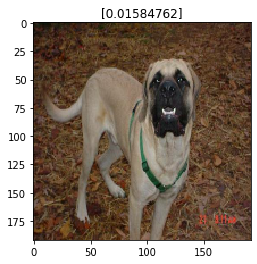

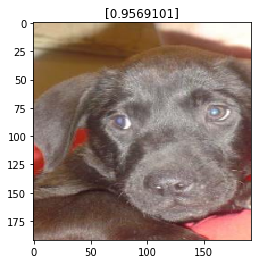

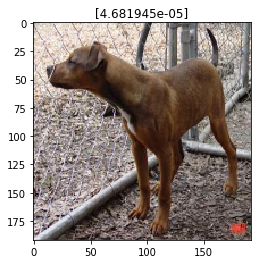

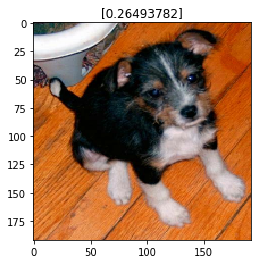

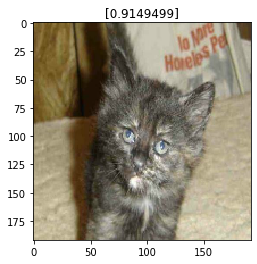

...

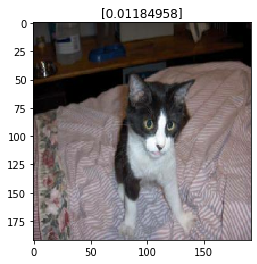

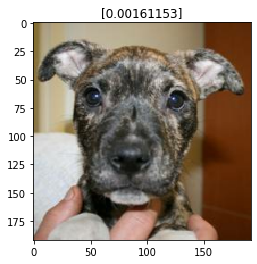

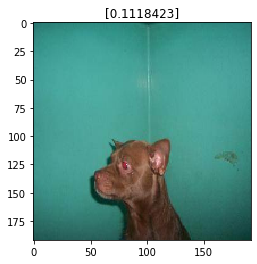

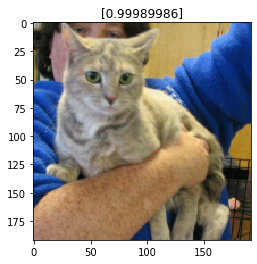

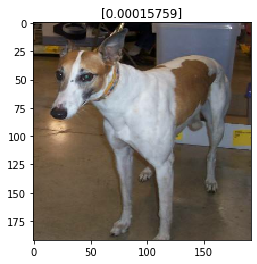

In [146]:
for example in full_val_ds.take(1):
  y_pred = model.predict(example)
  
  for i in range(len(y_pred)):
    plt.figure()
    plt.title(y_pred[i])
    plt.imshow(example[0][i])
    
plt.show()

* Nous aimerions savoir quelles sont les prédictions sur lesquelles le modèle s'est le plus trompé. Pour cela, nous allons définir une fonction *most_confused* qui bouclera sur tous les batchs de notre dataset de validation et sortira les MAE la plus élevée entre la prédiction et la valeur réelle. 
  * MAE (Mean Absolute Error) : `np.abs(y_pred - y_true)`

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


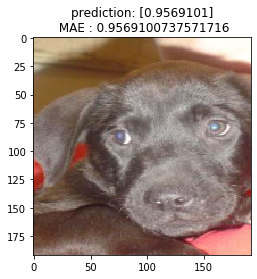

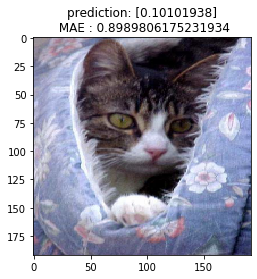

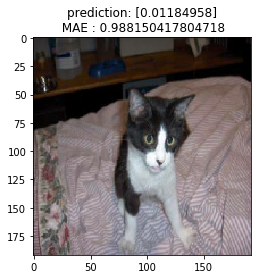

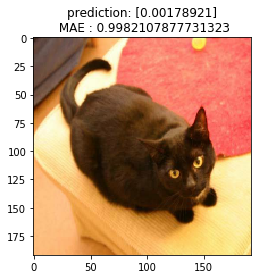

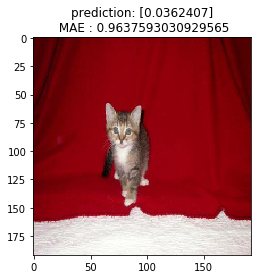

...

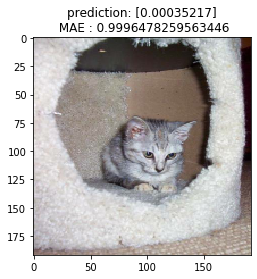

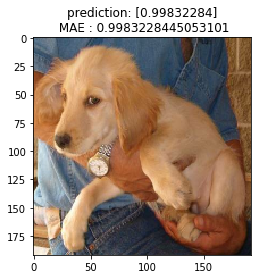

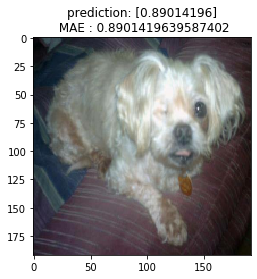

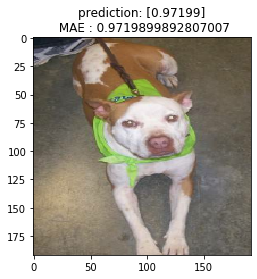

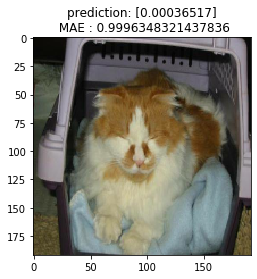

In [147]:
def most_confused(full_valid_ds, threshold):
  for example, labels in full_valid_ds.take(-1):
    y_pred = model.predict(example)
    mae = np.abs(y_pred.squeeze() - labels.numpy().squeeze())

    for i in np.where(mae>threshold)[0]:
      plt.figure()
      plt.title("prediction: {}\n MAE : {}".format(y_pred[i], mae[i]))
      plt.imshow(example[i])

  plt.show()
  
most_confused(full_val_ds, 0.8)

* Enfin, créons une matrice de confusion pour mieux comprendre où le modèle s'est trompé.

In [0]:
y_true = []
y_pred = []
for batch, true_labels in full_val_ds.take(-1):
  y_true += [true_labels.numpy()]
  y_pred += [model.predict_classes(batch)]

In [0]:
y_true = tf.concat([batch for batch in y_true], axis=0).numpy()
y_pred = tf.concat([batch for batch in y_pred], axis=0).numpy()

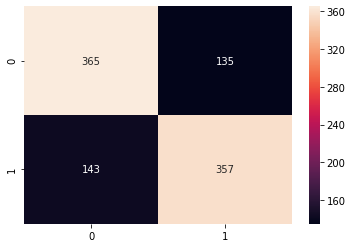

In [150]:
from sklearn.metrics import confusion_matrix 
import seaborn as sns 
cm = confusion_matrix(y_true, y_pred) #normalize = True
sns.heatmap(cm, annot=True, fmt='d')

Les erreurs sont équilibrées entre chien et chat.
Pour améliorer la performance du modèle, nous devrions : 
* Réduire l'overfitting
* Entrainer le modèle avec plus d'images